In [1]:
import sys
sys.path.append("..")

import pickle

from src.environments import *
from src.agents import *
from src.agent_utils import *

## Here we experiment on the LET (Light at the End of Tunnel) Corridor MAB

In [2]:
env = CorridorMAB.default(num_rooms = 10,
                          reward_distrib_params = [[-1,1], [-2,1], [-3,1], [-4,1], [-5,1], [-6,1], [-7,1], [-8,1], [-9,1], [10,1]],
                          move_penalty = -1)

# UCB (Upper Confidence Bound)

### We first test with UBE

In [14]:
len_episode = 500

color_codes = {'beta_102': "#00002f", 
               'beta_1': "#0000a4",
               'beta_05': "#006ffb",
               'beta_025': "#00fcfb",
               'beta_01': "#c259fb",
               'beta_001': "#0000a4"}

legend_codes = {'beta_102': r'$\beta = 1.2$', 
               'beta_1': r'$\beta = 1$',
               'beta_05': r'$\beta = 0.5$',
               'beta_025': r'$\beta = 0.25$',
               'beta_01': r'$\beta = 0.1$',
               'beta_001': r'$\beta = 0.01$'}


spl_ube = SimplePlotter('ubc_ube16',
                    env,
                    BayesianAgent.default(decision_making_method = 'UCB',
                                          decision_making_method_params = 1.2, 
                                          Q_method = 'predictive',
                                          u_method = 'UBE',
                                          name = 'beta_102', 
                                          gamma =  0.98),
                    BayesianAgent.default(decision_making_method = 'UCB',
                                          decision_making_method_params = 1, 
                                          Q_method = 'predictive',
                                          u_method = 'UBE',
                                          name = 'beta_1', 
                                          gamma =  0.98),
                    BayesianAgent.default(decision_making_method = 'UCB',
                                          decision_making_method_params = 0.5, 
                                          Q_method = 'predictive',
                                          u_method = 'UBE',
                                          name = 'beta_05', 
                                          gamma =  0.98))

spl_ube.run_experiments(len_episode, 1, fair_comparison = False)

100%|██████████| 500/500 [00:08<00:00, 59.02it/s]


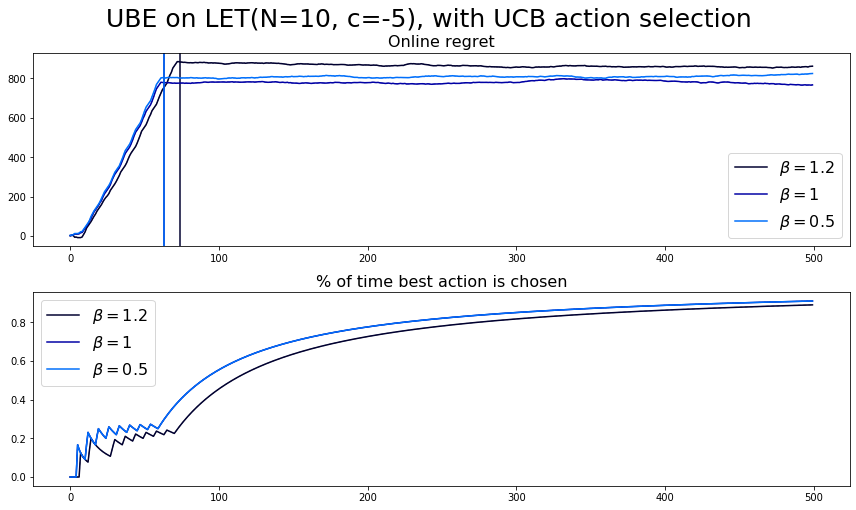

In [15]:
spl_ube.plot_regret(color_codes = color_codes, legend_codes = legend_codes, title = 'UBE on LET(N=10, c=-5), with UCB action selection')

### Then we test with EUDV

In [10]:
len_episode = 500

color_codes = {'beta_102': "#00002f", 
               'beta_1': "#0000a4",
               'beta_05': "#006ffb",
               'beta_025': "#00fcfb",
               'beta_01': "#c259fb",
               'beta_001': "#0000a4"}

legend_codes = {'beta_102': r'$\beta = 1.2$', 
               'beta_1': r'$\beta = 1$',
               'beta_05': r'$\beta = 0.5$',
               'beta_025': r'$\beta = 0.25$',
               'beta_01': r'$\beta = 0.1$',
               'beta_001': r'$\beta = 0.01$'}


spl_eudv = SimplePlotter('ubc_eudv14',
                    env,
                    BayesianAgent.default(decision_making_method = 'UCB',
                                          decision_making_method_params = 0.5, 
                                          Q_method = 'predictive',
                                          u_method = 'predictive',
                                          name = 'beta_05', 
                                          gamma =  0.98),
                    BayesianAgent.default(decision_making_method = 'UCB',
                                          decision_making_method_params = 0.1, 
                                          Q_method = 'predictive',
                                          u_method = 'predictive',
                                          name = 'beta_01', 
                                          gamma =  0.98),
                    BayesianAgent.default(decision_making_method = 'UCB',
                                          decision_making_method_params = 0.01, 
                                          Q_method = 'predictive',
                                          u_method = 'predictive',
                                          name = 'beta_001', 
                                          gamma =  0.98))

spl_eudv.run_experiments(len_episode, 1, fair_comparison = False)

100%|██████████| 500/500 [00:09<00:00, 50.07it/s]


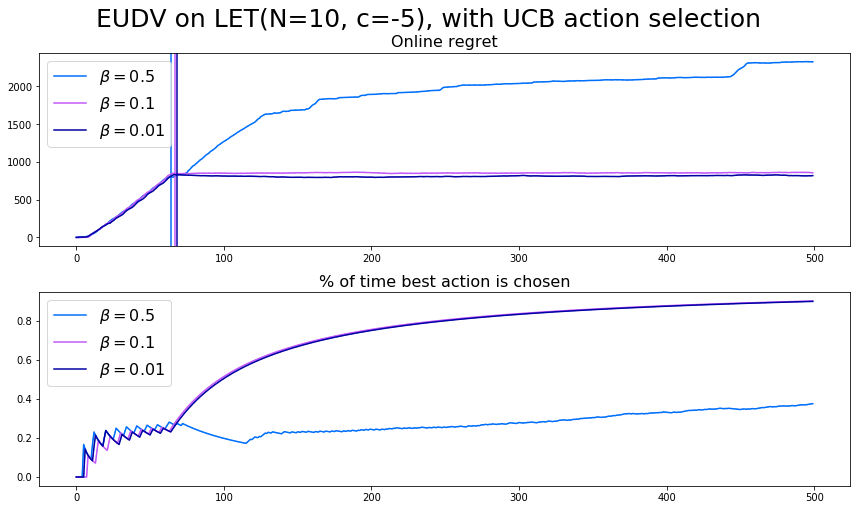

In [11]:
spl_eudv.plot_regret(color_codes = color_codes, legend_codes = legend_codes, title = 'EUDV on LET(N=10, c=-5), with UCB action selection')

### And finally with EUB

In [12]:
len_episode = 500

color_codes = {'beta_102': "#00002f", 
               'beta_1': "#0000a4",
               'beta_05': "#006ffb",
               'beta_025': "#00fcfb",
               'beta_01': "#c259fb",
               'beta_001': "#0000a4"}

legend_codes = {'beta_102': r'$\beta = 1.2$', 
               'beta_1': r'$\beta = 1$',
               'beta_05': r'$\beta = 0.5$',
               'beta_025': r'$\beta = 0.25$',
               'beta_01': r'$\beta = 0.1$',
               'beta_001': r'$\beta = 0.01$'}


spl_eub = SimplePlotter('ubc_eub10',
                    env,
                    BayesianAgent.default(decision_making_method = 'UCB',
                                          decision_making_method_params = 0.25, 
                                          Q_method = 'predictive',
                                          u_method = 'EUB',
                                          name = 'beta_025', 
                                          gamma =  0.98),
                    BayesianAgent.default(decision_making_method = 'UCB',
                                          decision_making_method_params = 0.1, 
                                          Q_method = 'predictive',
                                          u_method = 'EUB',
                                          name = 'beta_01', 
                                          gamma =  0.98),
                    BayesianAgent.default(decision_making_method = 'UCB',
                                          decision_making_method_params = 0.01, 
                                          Q_method = 'predictive',
                                          u_method = 'EUB',
                                          name = 'beta_001', 
                                          gamma =  0.98))

spl_eub.run_experiments(len_episode, 1, fair_comparison = False)

100%|██████████| 500/500 [02:27<00:00,  3.39it/s]


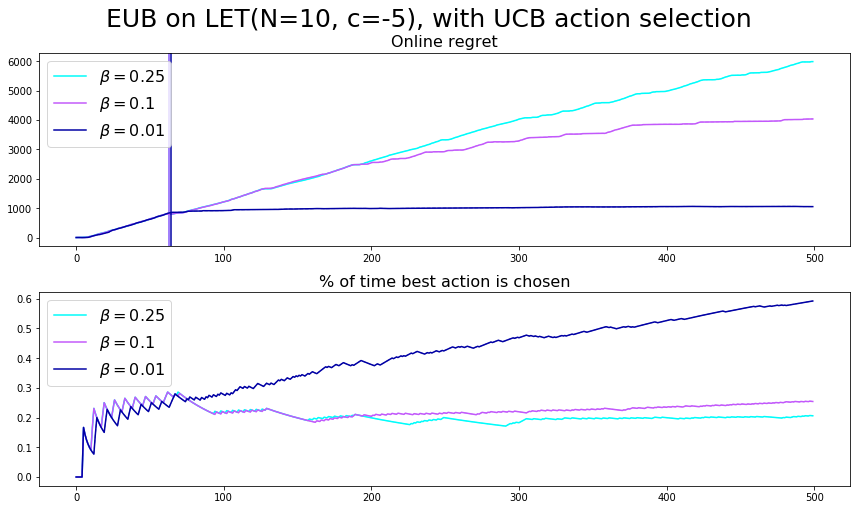

In [13]:
spl_eub.plot_regret(color_codes = color_codes, legend_codes = legend_codes, title = 'EUB on LET(N=10, c=-5), with UCB action selection')

# Thompson Sampling

### UBE

In [16]:
len_episode = 500

color_codes = {'beta_102': "#00002f", 
               'beta_1': "#0000a4",
               'beta_05': "#006ffb",
               'beta_025': "#00fcfb",
               'beta_01': "#c259fb",
               'beta_001': "#0000a4"}

legend_codes = {'beta_102': r'$\beta = 1.2$', 
               'beta_1': r'$\beta = 1$',
               'beta_05': r'$\beta = 0.5$',
               'beta_025': r'$\beta = 0.25$',
               'beta_01': r'$\beta = 0.1$',
               'beta_001': r'$\beta = 0.01$'}


spl_ube = SimplePlotter('ts_ube',
                    env,
                    BayesianAgent.default(decision_making_method = 'ThompsonSampling',
                                          decision_making_method_params = 1.2, 
                                          Q_method = 'predictive',
                                          u_method = 'UBE',
                                          name = 'beta_102', 
                                          gamma =  0.98),
                    BayesianAgent.default(decision_making_method = 'ThompsonSampling',
                                          decision_making_method_params = 1, 
                                          Q_method = 'predictive',
                                          u_method = 'UBE',
                                          name = 'beta_01', 
                                          gamma =  0.98),
                    BayesianAgent.default(decision_making_method = 'ThompsonSampling',
                                          decision_making_method_params = 0.5, 
                                          Q_method = 'predictive',
                                          u_method = 'UBE',
                                          name = 'beta_05', 
                                          gamma =  0.98))

spl_ube.run_experiments(len_episode, 1, fair_comparison = False)

100%|██████████| 500/500 [00:08<00:00, 57.01it/s]


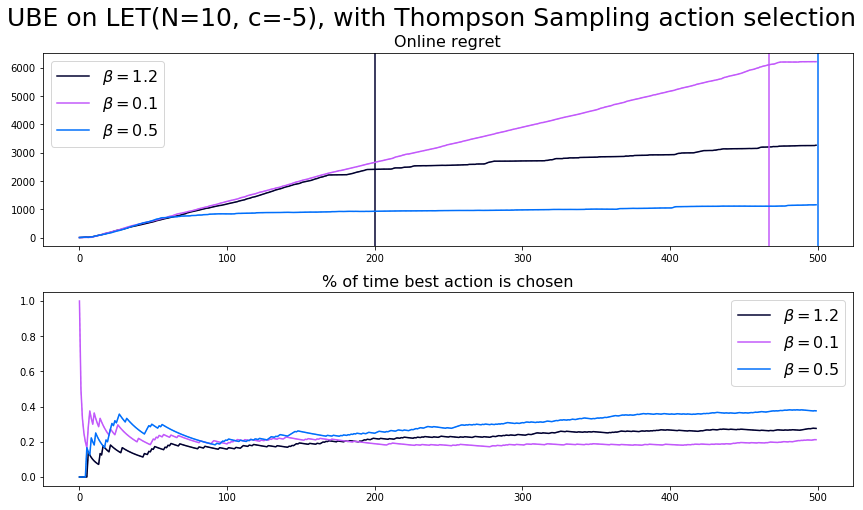

In [18]:
spl_ube.plot_regret(color_codes = color_codes, legend_codes = legend_codes, title = 'UBE on LET(N=10, c=-5), with Thompson Sampling action selection')

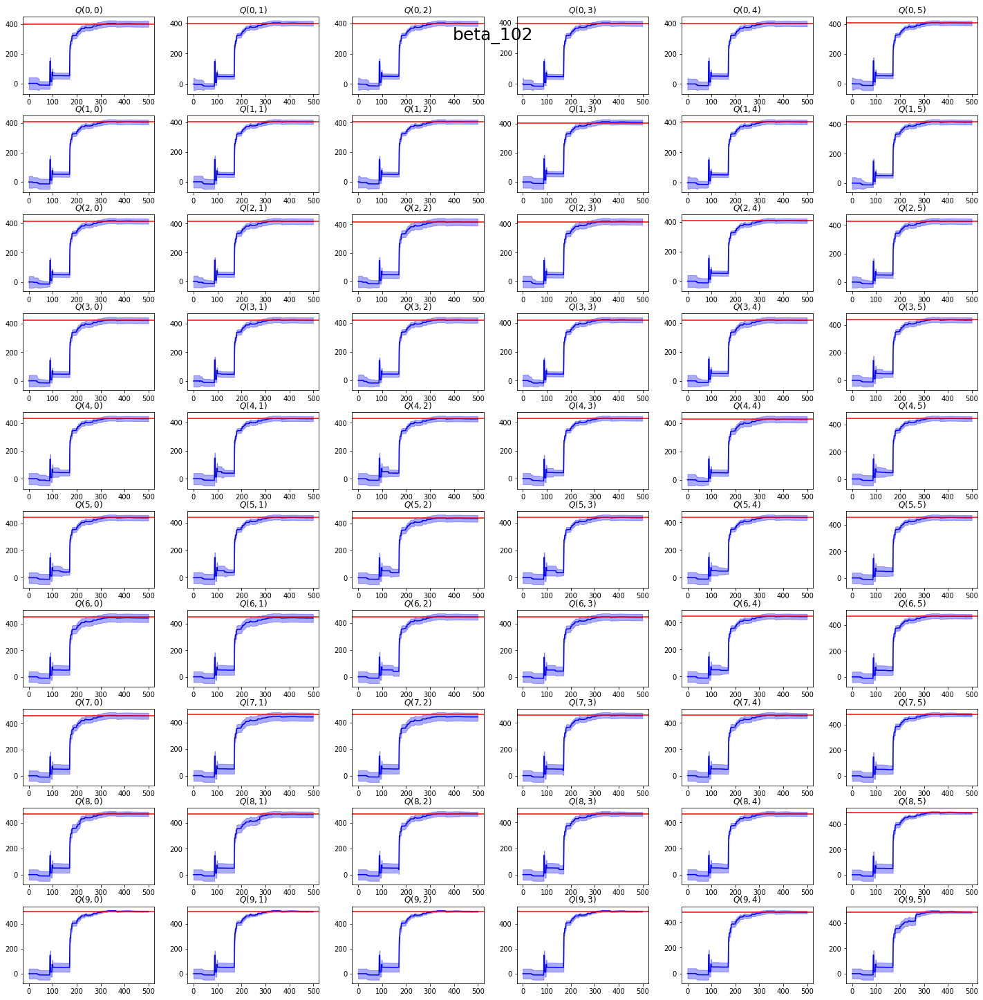

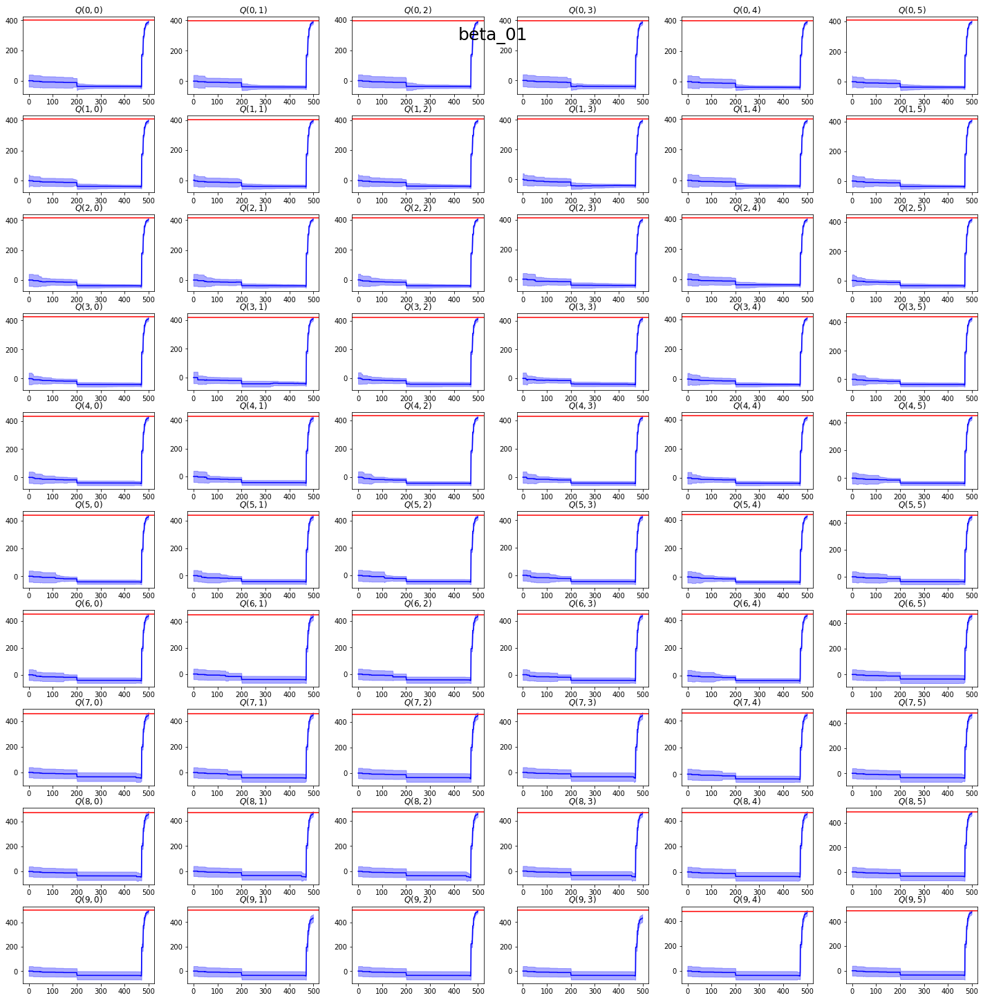

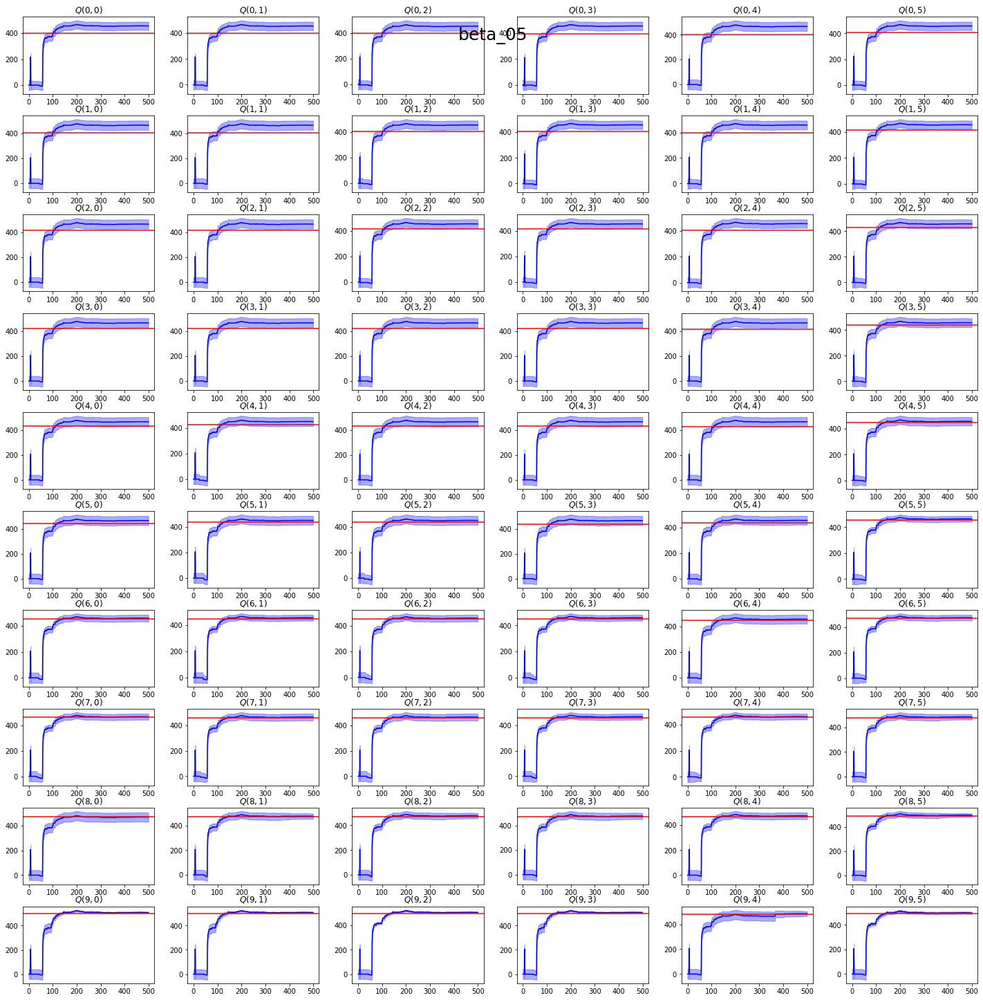

In [31]:
spl_ube.plot_Q_u()

### EUDV

In [21]:
len_episode = 500

color_codes = {'beta_102': "#00002f", 
               'beta_1': "#0000a4",
               'beta_05': "#006ffb",
               'beta_025': "#00fcfb",
               'beta_01': "#c259fb",
               'beta_001': "#0000a4"}

legend_codes = {'beta_102': r'$\beta = 1.2$', 
               'beta_1': r'$\beta = 1$',
               'beta_05': r'$\beta = 0.5$',
               'beta_025': r'$\beta = 0.25$',
               'beta_01': r'$\beta = 0.1$',
               'beta_001': r'$\beta = 0.01$'}


spl_eudv = SimplePlotter('ts_eudv1',
                    env,
                    BayesianAgent.default(decision_making_method = 'ThompsonSampling',
                                          decision_making_method_params = 0.5, 
                                          Q_method = 'predictive',
                                          u_method = 'predictive',
                                          name = 'beta_05', 
                                          gamma =  0.98),
                    BayesianAgent.default(decision_making_method = 'ThompsonSampling',
                                          decision_making_method_params = 0.1, 
                                          Q_method = 'predictive',
                                          u_method = 'predictive',
                                          name = 'beta_01', 
                                          gamma =  0.98),
                    BayesianAgent.default(decision_making_method = 'ThompsonSampling',
                                          decision_making_method_params = 0.01, 
                                          Q_method = 'predictive',
                                          u_method = 'predictive',
                                          name = 'beta_001', 
                                          gamma =  0.98))

spl_eudv.run_experiments(len_episode, 1, fair_comparison = False)

100%|██████████| 500/500 [00:13<00:00, 38.04it/s]


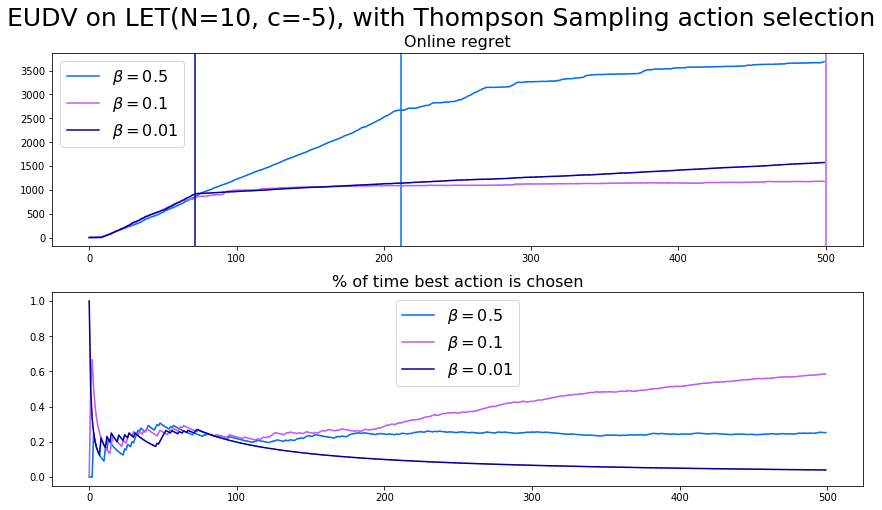

In [22]:
spl_eudv.plot_regret(color_codes = color_codes, legend_codes = legend_codes, title = 'EUDV on LET(N=10, c=-5), with Thompson Sampling action selection')

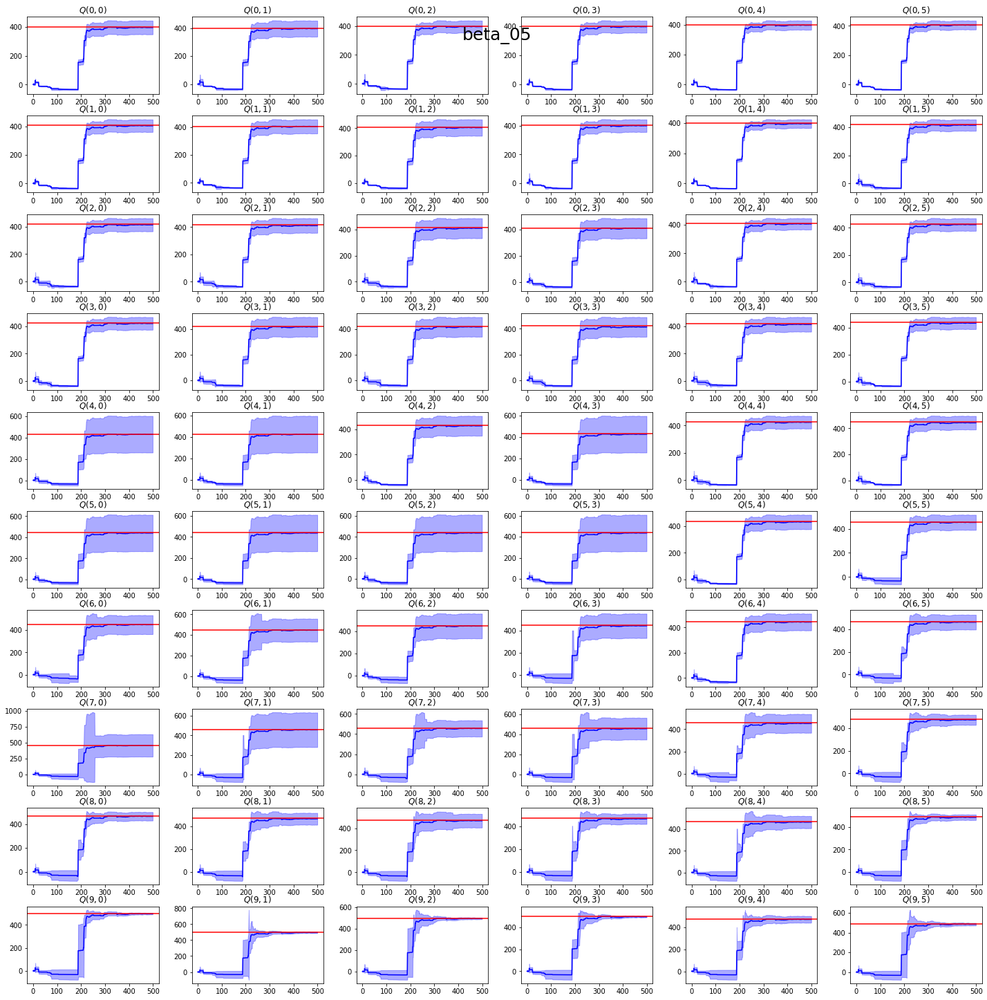

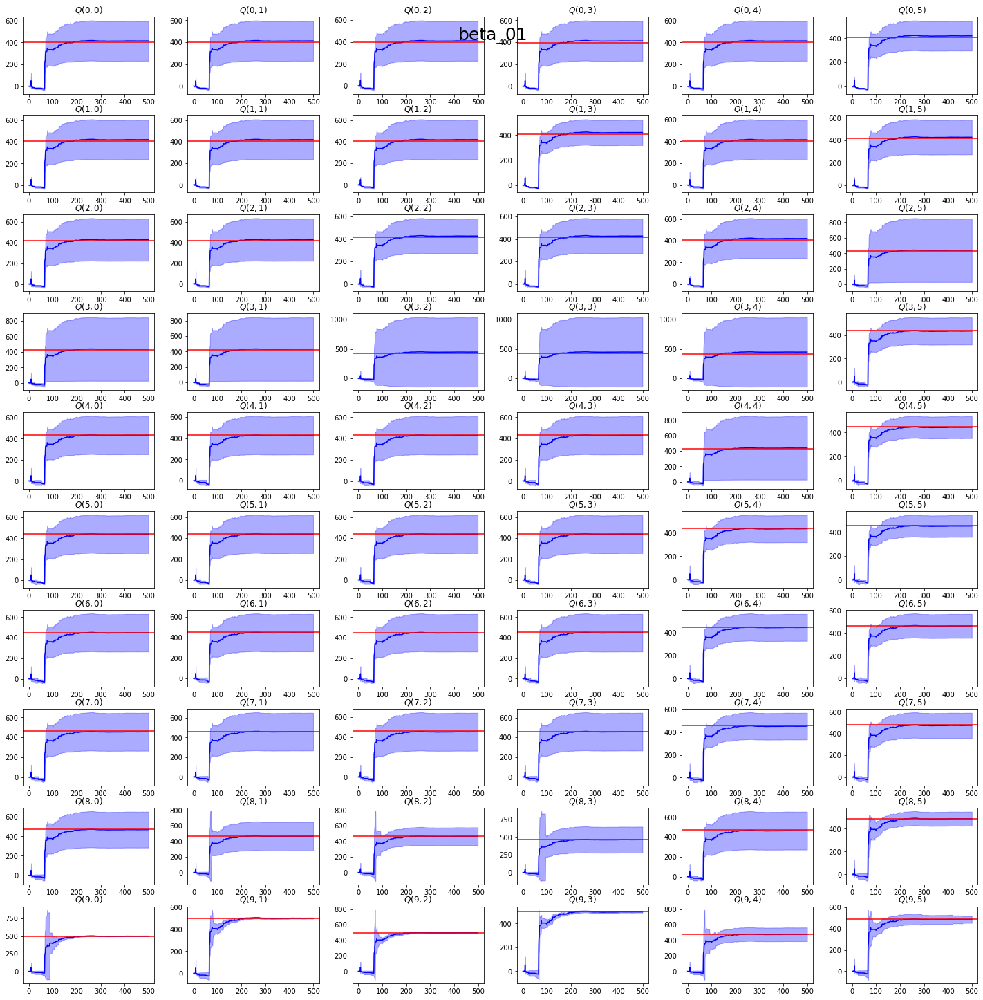

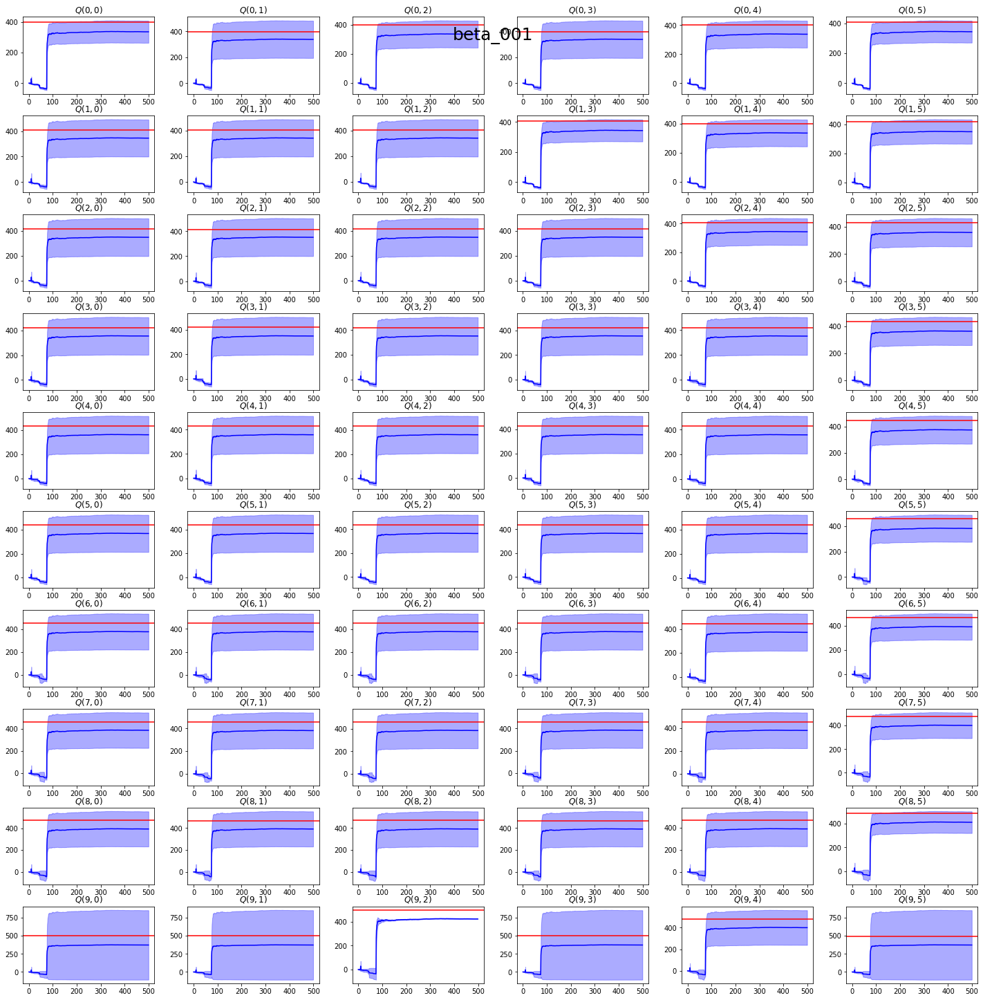

In [30]:
spl_eudv.plot_Q_u()

### EUB

We can see that EUB exhibits this pathological behaviour, that when he finds the good state, immediately the uncertainty about all the other states it saw before increases

In [26]:
len_episode = 500

color_codes = {'beta_102': "#00002f", 
               'beta_1': "#0000a4",
               'beta_05': "#006ffb",
               'beta_025': "#00fcfb",
               'beta_01': "#c259fb",
               'beta_001': "#0000a4"}

legend_codes = {'beta_102': r'$\beta = 1.2$', 
               'beta_1': r'$\beta = 1$',
               'beta_05': r'$\beta = 0.5$',
               'beta_025': r'$\beta = 0.25$',
               'beta_01': r'$\beta = 0.1$',
               'beta_001': r'$\beta = 0.01$'}


spl_eub = SimplePlotter('ts_eub1',
                    env,
                    BayesianAgent.default(decision_making_method = 'ThompsonSampling',
                                          decision_making_method_params = 0.25, 
                                          Q_method = 'predictive',
                                          u_method = 'EUB',
                                          name = 'beta_025', 
                                          gamma =  0.98),
                    BayesianAgent.default(decision_making_method = 'UCB',
                                          decision_making_method_params = 0.1, 
                                          Q_method = 'predictive',
                                          u_method = 'EUB',
                                          name = 'beta_01', 
                                          gamma =  0.98),
                    BayesianAgent.default(decision_making_method = 'UCB',
                                          decision_making_method_params = 0.01, 
                                          Q_method = 'predictive',
                                          u_method = 'EUB',
                                          name = 'beta_001', 
                                          gamma =  0.98))

spl_eub.run_experiments(len_episode, 1, fair_comparison = False)

100%|██████████| 500/500 [02:02<00:00,  4.07it/s]


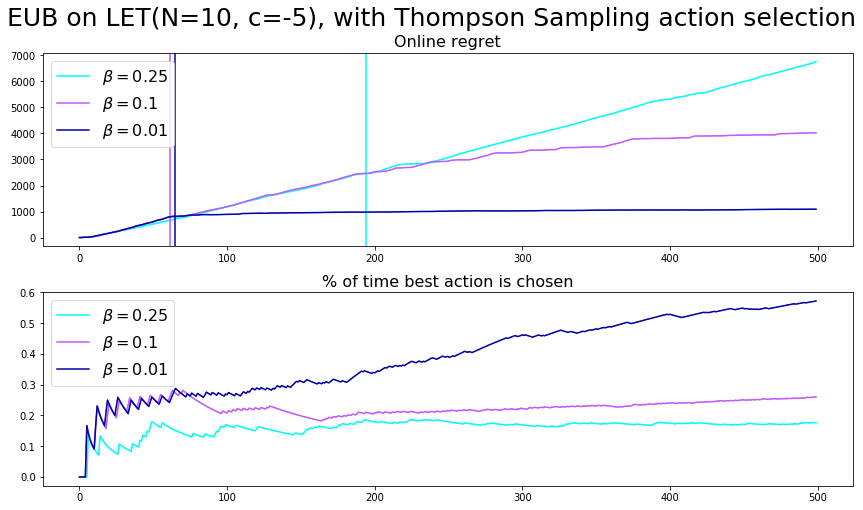

In [28]:
spl_eub.plot_regret(color_codes = color_codes, legend_codes = legend_codes, title = 'EUB on LET(N=10, c=-5), with Thompson Sampling action selection')

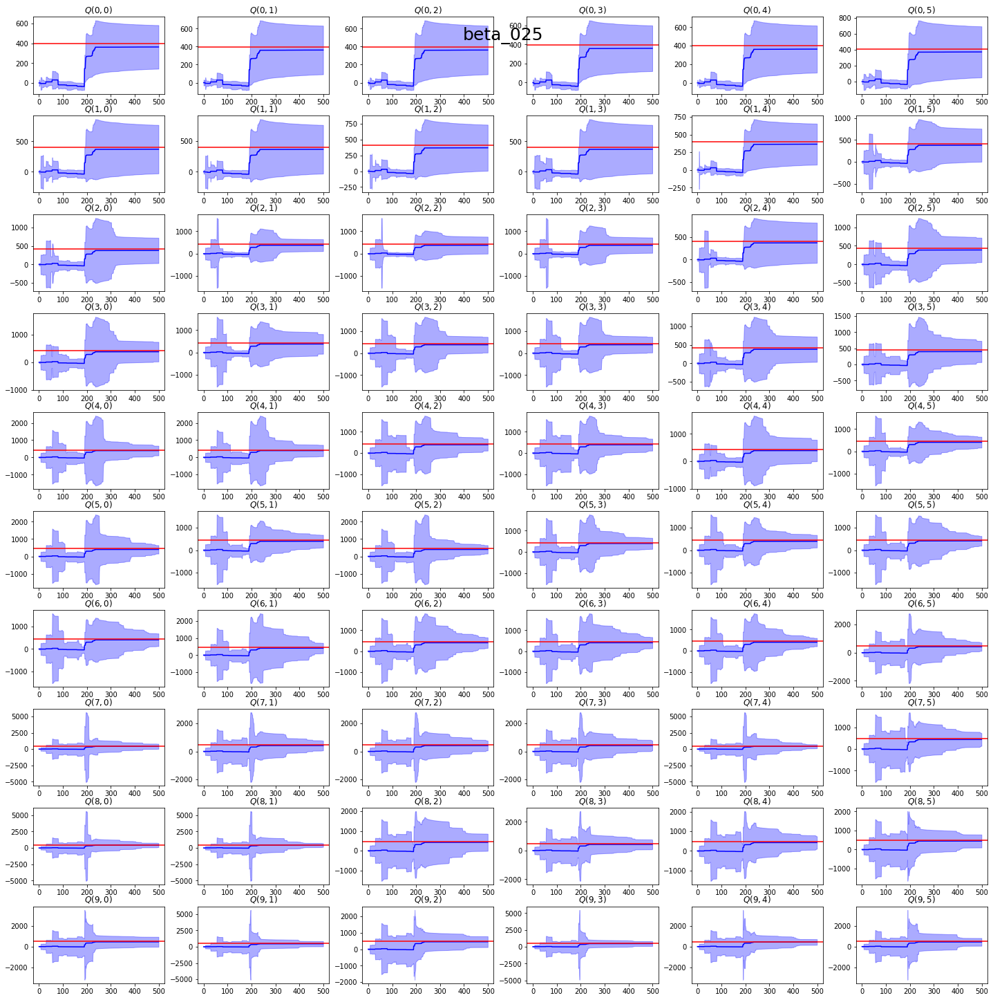

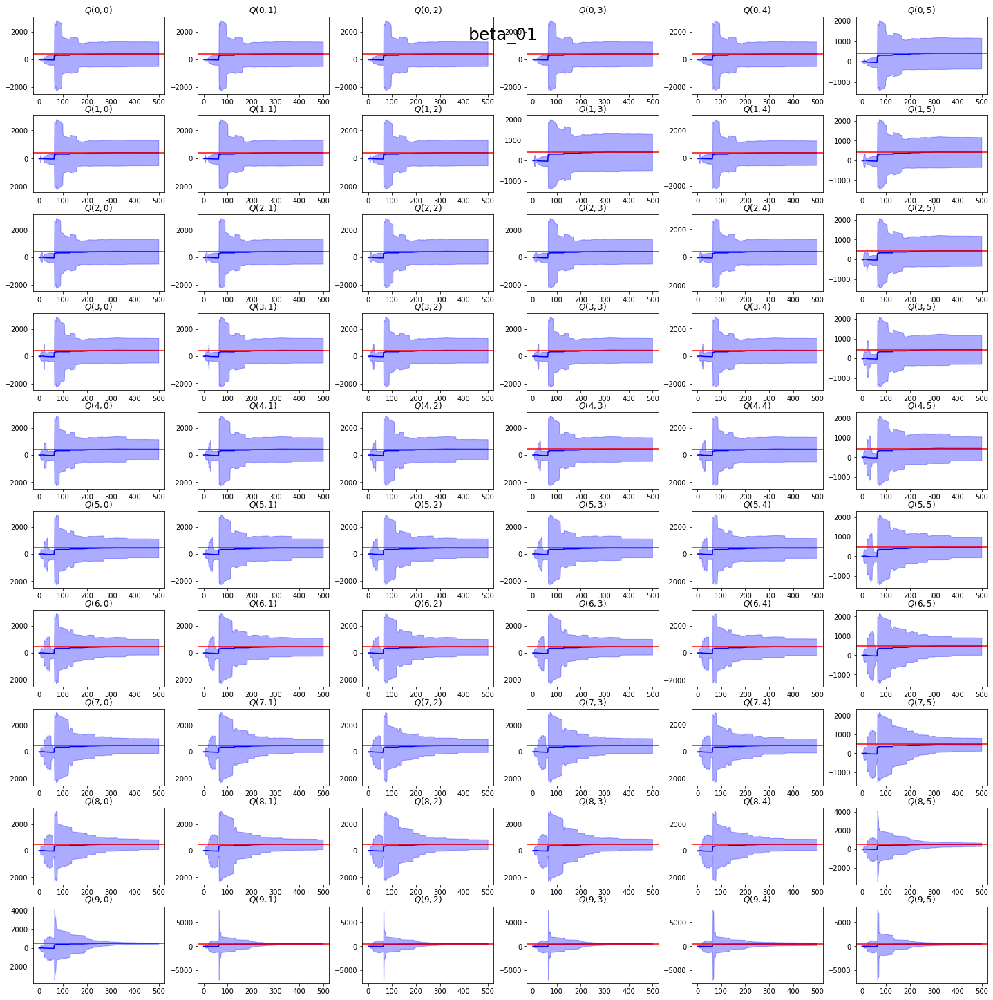

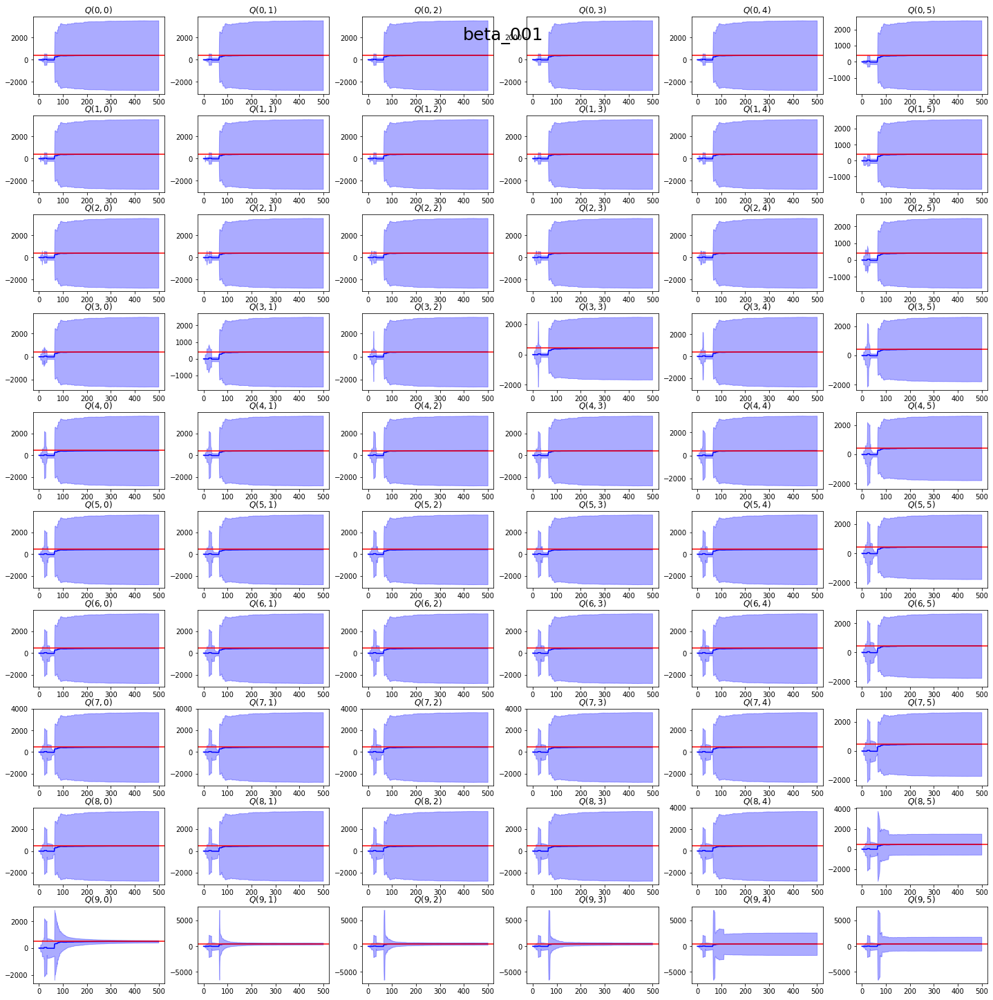

In [29]:
spl_eub.plot_Q_u()

# GKG1

### UBE

In [3]:
len_episode = 500

color_codes = {'ube_gkg': "#00002f", 
               'ube_gkg_bo': "#0000a4",
               'beta_05': "#006ffb",
               'beta_025': "#00fcfb",
               'beta_01': "#c259fb",
               'beta_001': "#0000a4"}

legend_codes = {'ube_gkg': 'ube_gkg',
                'ube_gkg_bo': 'ube_gkg_bo'}


spl_ube = SimplePlotter('gkg_ube',
                    env,
                    BayesianAgent.default(decision_making_method = 'GKG1',
                                          Q_method = 'predictive',
                                          u_method = 'UBE',
                                          name = 'ube_gkg', 
                                          gamma =  0.98),
                    BayesianAgent.default(decision_making_method = 'GKG1_BO',
                                          Q_method = 'predictive',
                                          u_method = 'UBE',
                                          name = 'ube_gkg_bo', 
                                          gamma =  0.98))

spl_ube.run_experiments(len_episode, 1, fair_comparison = False)

 12%|█▏        | 60/500 [00:49<08:24,  1.15s/it]

KeyboardInterrupt: 